### Author: Hans-Georg Steinrück, hgs@slac.stanford.edu

# Data-processing for GID

## uses pygix from https://github.com/tgdane/pygix/wiki
## for other examples than outlined below https://github.com/tgdane/pygix/wiki/3.-Description-of-usage

##### seems to only work with python2

### Import python libraries

In [35]:
# numpy and plotting
import numpy as np
import pylab
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
from matplotlib import ticker
from pylab import *
# from PIL import Image

# don't know what it is
import pickle
# import path
from os import walk, path, makedirs
from scipy import interpolate
# import seaborn as sns
import os

# data-handling
import re
from copy import deepcopy
from glob import glob
import timeit

# pyFAI
import pyFAI
from pyFAI.multi_geometry import MultiGeometry
from pyFAI.calibrant import get_calibrant
# from pyFAI.gui import jupyter

# pygix
import pygix

import fabio
import pygix.plotting as pp
from pygix import plotting as ppl

# inline plotting
get_ipython().magic('matplotlib inline')
import mpld3
mpld3.enable_notebook()
# import EdfFile
# activate ipykernel_py2

import lmfit
from lmfit import  Model, Parameters
from lmfit import minimize, Minimizer, Parameters, Parameter, report_fit

### Cd to directory containing images

In [20]:
dataFile = "F:\\N2200 Project\\data\\ssrl\\waxs\\cb_hi_nogr_0_01190534_0001.tif"

# T170001.edf

### Read an image and display it

In [26]:
data = fabio.open(dataFile).data
# data = np.rot90(data)
# data = np.flipud(data)
deldel = -0.8 # del value of detector
### Fabio cannot read SSRL .raw files, that's why I use the raw_read function in the xrd processing
### data can be masked with pyFAI, not done here
# ppl.implot(data) # make sure that this is not upside down, left-right doesn't appear to matter (but make sure center-pixel is correct)

### Define pyFai detector parameters

In [22]:
### Detector pixel size
det_pix = [73.242e-6, 73.242e-6]

detector = pyFAI.detectors.Detector(det_pix[0], det_pix[1])

### Wavelength
wl = 0.976254e-10

### Center-pixel and sample-to-detector distance
centerx =  1532.42 #590.65
centery = 3034.23  #44.737
sdd = 0.339316           #0.42746 

### Beamcenter from sample view in meters from lower left of detector
poni1 = centery * det_pix[1]; poni2 = centerx * det_pix[0]

### detector rotations from sample view
rot1 = deldel /180 * np.pi # move detector to right, in-plane angle# in radians
rot2 = 0.0    /180 * np.pi # move detector down, out-of-plane angle
rot3 = 0.0    /180 * np.pi # clockwise rotation

### Setup detector geometry

In [23]:
pg = pygix.Transform(dist = sdd, poni1 = poni1, poni2 = poni2, rot1 = rot1,
                     rot2 = rot2, rot3 = rot3, wavelength = wl, detector=detector)

### Setup sample geometry parameters

In [24]:
pg.sample_orientation = 1     # 1 is horizontal, 2 is vertical
pg.incident_angle = 0.08     # indicent angle in deg
pg.tilt_angle = 0             # tilt angle of sample in deg (misalignment in "chi")
pg # optionally print geometry

Detector Detector	 Spline= None	 PixelSize= 7.324e-05, 7.324e-05 m
Wavelength= 9.762540e-11m
SampleDetDist= 3.393160e-01m	PONI= 2.222331e-01, 1.122375e-01m	rot1=-0.013963  rot2= 0.000000  rot3= 0.000000 rad
DirectBeamDist= 339.349mm	Center: x=1597.110, y=3034.230 pix	Tilt=0.800 deg  tiltPlanRotation= 0.000 deg

### Get qz-qxy data

In [30]:
ii, qxy, qz = pg.transform_reciprocal(data)

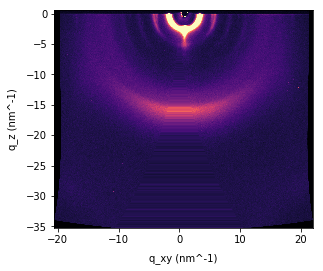

(<matplotlib.figure.Figure at 0x3b0034e0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x3af79ba8>)

In [40]:
ppl.implot(ii, qxy, qz, mode='rsm', cmap='magma')

### out-of-plane profile

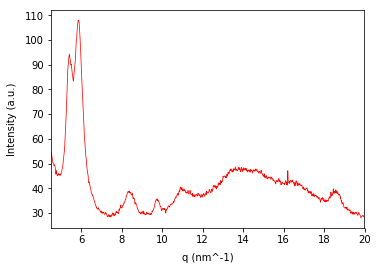

In [59]:
line_out, q_out = pg.profile_ip_box(data, npt=1000, op_pos=.1, op_width=2, ip_range=(4.5, 20))
ppl.plot(q_out,line_out)

In [13]:
output = np.column_stack((qxy/10,ii)) # divide by ten to get to 1/A (instead of 1/nm)
np.savetxt("%s.qr"%dataFile,output)

### in-plane profile

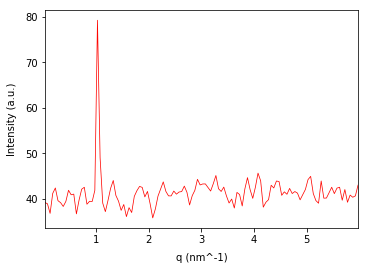

In [14]:
ii, qz = pg.profile_op_box(data, npt=120, ip_pos=1.5, ip_width=0.2, op_range=(0,20))
ppl.plot(qz,ii)

In [15]:
### q-profile, doesn't make sense for this sample

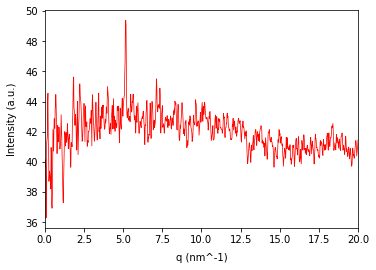

In [16]:
i, q = pg.profile_sector(data, npt=1000, chi_pos=0, chi_width=20, radial_range=(0, 20), unit='q_nm^-1')
ppl.plot(q,i)

### chi-profile, doesn't make sense for this sample

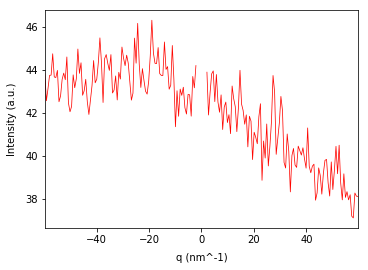

In [17]:
i, chi = pg.profile_chi(data, npt=200, radial_pos=7.7, radial_width=1.0, chi_range=(-60, 60))
ppl.plot(chi,i)

### q-chi map, doesn't make sense for this sample

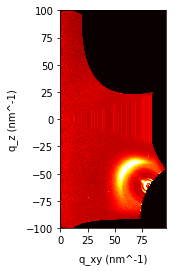

(<matplotlib.figure.Figure at 0x3c6ddbe0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x3c70aa90>)

In [18]:
intensity, q_abs, chi = pg.transform_polar(data, npt=(1000, 720))
ppl.implot(intensity, q_abs, chi, mode='rsm')